# Visualizing mexican wildfires during 2017 with folium


The incidence of fires in size, frequency, and intensity has increased significantly around the world. Mexico, a mega-diverse country, has recurring forest fires, especially in the El Niño years. However, in Mexico, fires are caused mainly by humans, and factors like road accessibility and distance to towns are commonly associated with their frequency and distribution [[1]](https://library.itc.utwente.nl/papers_2008/msc/nrm/orozco.pdf ). The general objective of this tutorial is to show how to use data science visualization tools, but in a particular way, the **`folium`**  module, to understand the fires in Mexico during 2017.



In [1]:
import numpy as np
import pandas as pd
pd.set_option('display.max_columns', 60)
pd.set_option('display.max_rows', 60)
import matplotlib.pyplot as plt
import seaborn as sns
import datetime

from astroML.plotting import setup_text_plots
setup_text_plots(usetex = True)

#Style sheet
plt.style.use('seaborn-paper')

colours = [ '#264653', '#2A9D8F', '#E9C46A', '#F4A261', '#E76F51']

load_data = 'data/Annual_Fire_History_Series_MX_(2017).xlsx'

# CONAFOR database

In Mexico, prevention and control of forest fires are carried out by the National Forest Fire Protection Program (CONAFOR, by its Spanish acronym), and we will use its database obtained for the year 2017 through the following links:



[2] https://www.datos.gob.mx/busca/organization/conafor

[3] http://187.218.230.4/OpenData/Incendios/ 

In [2]:
df = pd.read_excel(load_data)
df.head()

,Número de Incendio,Clave del incendio,Grados,Minutos,Segundos,Grados.1,Minutos.1,Segundos.1,Clave municipio,Estado,Municipio,Predio,Causa,Causa especifica,Fecha Inicio,Fecha Termino,Duración días,Tipo de incendio,ANP,ANP hectareas,Tipo Vegetación,Tipo impacto,Arbolado Adulto,Renuevo,Arbustivo,Herbáceo,Hojarasca,Suelo Organico,Total,Tamaño,...,Tipo,Region,Unnamed: 52,Unnamed: 53,Unnamed: 54,Unnamed: 55,Unnamed: 56,Unnamed: 57,Unnamed: 58,Unnamed: 59,Unnamed: 60,Unnamed: 61,Unnamed: 62,Unnamed: 63,Unnamed: 64,Unnamed: 65,Unnamed: 66,Unnamed: 67,Unnamed: 68,Unnamed: 69,Unnamed: 70,Unnamed: 71,Unnamed: 72,Unnamed: 73,Unnamed: 74,Unnamed: 75,Unnamed: 76,Unnamed: 77,Unnamed: 78,Unnamed: 79
0,1,17-01-0001,21,53,53.70,102,49,18.80,3,Aguascalientes,Calvillo,Tanque de los Serna,Intencional,Vandalismo,2017-01-03,2017-01-03,1 Día,Superficial,C.A.D.N.R. 001 Pabellón,1.78,Pastizal Natural - PN,Impacto Mínimo,0.0,0.0,0.00,1.78,0.0,0.0,1.78,0 a 5 Hectáreas,...,Federal,Occidente,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,17-01-0002,21,49,44.00,102,7,26.40,10,Aguascalientes,El Llano,La Tinaja,Fumadores,Ninguna / No aplica,2017-01-07,2017-01-07,1 Día,Superficial,0,0.00,Pastizal Natural - PN,Impacto Mínimo,0.0,0.0,1.37,8.44,0.0,0.0,9.81,6 a 10 Hectáreas,...,NaN,Occidente,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,17-01-0003,21,52,3.25,102,23,30.00,1,Aguascalientes,Aguascalientes,San Martín,Fumadores,Ninguna / No aplica,2017-01-08,2017-01-08,1 Día,Superficial,0,0.00,Pastizal Natural - PN,Impacto Mínimo,0.0,0.0,7.98,86.30,0.0,0.0,94.28,51 a 100 Hectáreas,...,NaN,Occidente,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,4,17-01-0004,21,43,17.12,102,21,52.45,1,Aguascalientes,Aguascalientes,Ejido Palomas,Intencional,Vandalismo,2017-01-08,2017-01-08,1 Día,Superficial,0,0.00,Pastizal Natural - PN,Impacto Mínimo,0.0,0.0,0.32,39.56,0.0,0.0,39.88,21 a 50 Hectáreas,...,NaN,Occidente,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,5,17-01-0005,21,59,14.80,102,12,34.54,11,Aguascalientes,San Francisco de los Romo,Ejido Cañada Honda,Fumadores,Ninguna / No aplica,2017-01-10,2017-01-10,1 Día,Superficial,0,0.00,Matorral Crasicaule - MC,Impacto Mínimo,0.0,0.0,2.85,53.47,0.0,0.0,56.32,51 a 100 Hectáreas,...,NaN,Occidente,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [3]:
#rename relevant columns
renamed_columns = {'Grados': 'Degrees', 'Minutos': 'Minutes', 'Segundos':'Seconds',
                  'Grados.1': 'Degrees.1', 'Minutos.1': 'Minutes.1', 'Segundos.1':'Seconds.1',
                  'Duración días': 'Duration time (days)', 'Total':'Affected area (ha)', 'Estado': 'STATE'}
df.rename(columns=renamed_columns, inplace=True)

# Data exploration


First of all, a basic exploration of the data from CONAFOR will be carried out.

* **Structure of the _data frame_**


In [4]:
print('Number of rows: {}'.format(df.shape[0]))
print('Number of columns : {}'.format(df.shape[1]))

Number of rows: 8896
Number of columns : 80


* **Column names**

In [5]:
print("Column names:\n")
df.columns.values

Column names:



array(['Número de Incendio', 'Clave del incendio', 'Degrees', 'Minutes',
       'Seconds', 'Degrees.1', 'Minutes.1', 'Seconds.1',
       'Clave municipio', 'STATE', 'Municipio', 'Predio', 'Causa',
       'Causa especifica', 'Fecha Inicio', 'Fecha Termino',
       'Duration time (days)', 'Tipo de incendio', 'ANP', 'ANP hectareas',
       'Tipo Vegetación', 'Tipo impacto', 'Arbolado Adulto', 'Renuevo',
       'Arbustivo', 'Herbáceo', 'Hojarasca', 'Suelo Organico',
       'Affected area (ha)', 'Tamaño', 'Detección', 'Llegada', 'Duración',
       'Costos', 'Superficie Salvada', 'CO2 emitido', 'CO2 Evitó emitir',
       'CONAFOR', 'CONAFOR Servicios Externos',
       'CONAFOR Servicios Convenio de Gob. Del Edo y/o Asociaciones Regionales de Silvicultores',
       'CONANP', 'SEDENA', 'SEMAR', 'Gobierno del Estado', 'Municipios',
       'Propietarios de Terrenos Forestales', 'Voluntarios', 'Federales',
       'Total.1', 'Categoria', 'Tipo ', 'Region', 'Unnamed: 52',
       'Unnamed: 53', 'Unn

* **Type of data**

In [6]:
df.dtypes

Número de Incendio      int64
Clave del incendio     object
Degrees                object
Minutes                 int64
Seconds               float64
                       ...   
Unnamed: 75           float64
Unnamed: 76           float64
Unnamed: 77           float64
Unnamed: 78           float64
Unnamed: 79           float64
Length: 80, dtype: object

* **Statistical summary of the data set**




In [7]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
Número de Incendio,8896.0,321.655576,310.084150,1.00000,84.000000,223.000000,469.250000,1450.00
Minutes,8896.0,26.550135,17.955518,0.00000,10.000000,25.000000,42.000000,59.00
Seconds,8896.0,29.508093,17.342596,0.00000,14.470604,29.155000,44.500000,60.00
Degrees.1,8896.0,99.813737,10.063309,-101.00000,98.000000,99.000000,103.000000,117.00
Minutes.1,8896.0,27.669852,17.695581,0.00000,12.000000,27.000000,43.000000,59.00
Seconds.1,8896.0,29.498771,17.488788,0.00000,14.300000,29.200000,44.700000,83.00
Clave municipio,8896.0,55.065085,67.560273,1.00000,12.000000,32.000000,80.000000,570.00
ANP hectareas,8896.0,14.648575,181.019664,0.00000,0.000000,0.000000,0.000000,6342.37
Arbolado Adulto,8896.0,2.423268,44.026736,0.00000,0.000000,0.000000,0.000000,3000.00
Renuevo,8896.0,1.653073,16.726214,0.00000,0.000000,0.000000,0.000000,755.00


* **Missing data**


In [8]:
missing_values = df.isnull().sum()
missing_values

Número de Incendio       0
Clave del incendio       0
Degrees                  0
Minutes                  0
Seconds                  0
                      ... 
Unnamed: 75           8896
Unnamed: 76           8896
Unnamed: 77           8896
Unnamed: 78           8896
Unnamed: 79           8896
Length: 80, dtype: int64

In [9]:
# ============= Percentage of missing values =============== #

# how many total missing values do we have?
total_cells = np.product(df.shape)
total_missing = missing_values.sum()

# percent of data that is missing
perc_nan_rows = (total_missing/total_cells) * 100

print('We have {} % of missing data'.format(perc_nan_rows) )

We have 36.71565872302158 % of missing data


In [10]:
# ============ Missing values of each variable (column) ============== #

# summarize the number of rows with missing values for each column
for i in df.columns.values:
  # count number of rows with missing values
    n_miss = df[i].isnull().sum()
    perc = n_miss / df[i].shape[0] * 100
    if n_miss != 0 :
        print(i, 'has', n_miss , 'missing values, equivalent to', perc, ' % from its total values\n')

Categoria has 6099 missing values, equivalent to 68.55890287769785  % from its total values

Tipo  has 6112 missing values, equivalent to 68.70503597122301  % from its total values

Unnamed: 52 has 8895 missing values, equivalent to 99.98875899280576  % from its total values

Unnamed: 53 has 8896 missing values, equivalent to 100.0  % from its total values

Unnamed: 54 has 8896 missing values, equivalent to 100.0  % from its total values

Unnamed: 55 has 8896 missing values, equivalent to 100.0  % from its total values

Unnamed: 56 has 8896 missing values, equivalent to 100.0  % from its total values

Unnamed: 57 has 8896 missing values, equivalent to 100.0  % from its total values

Unnamed: 58 has 8896 missing values, equivalent to 100.0  % from its total values

Unnamed: 59 has 8896 missing values, equivalent to 100.0  % from its total values

Unnamed: 60 has 8896 missing values, equivalent to 100.0  % from its total values

Unnamed: 61 has 8896 missing values, equivalent to 100.0  %

In [11]:
df.dropna(axis=1, inplace = True)

# Conversion of units

## Suspicious data

Before any transformation, we must make sure that the data is numeric type

In [12]:
df['Degrees'].value_counts()

19     4068
20      844
18      616
26      487
16      468
21      392
22      349
25      299
17      290
23      234
27      203
28      125
32      112
24      102
31       87
15       85
0        52
29       35
30       35
14        6
25        2
26        2
23        1
19°       1
21        1
Name: Degrees, dtype: int64

we have to change **19°** to a numerical data

In [13]:
Degrees_changed = np.where( df['Degrees'].values != '19°', df['Degrees'].values, 19 )
df['Degrees'] = Degrees_changed
df['Degrees'].value_counts()

19    4069
20     844
18     616
26     487
16     468
21     392
22     349
25     299
17     290
23     234
27     203
28     125
32     112
24     102
31      87
15      85
0       52
29      35
30      35
14       6
25       2
26       2
23       1
21       1
Name: Degrees, dtype: int64

## Conversion function

Using the columns of "Degrees", "Minutes" and "Seconds" we find the decimal degrees for latitude and longitude, through the following function:


In [14]:
def degres2decimal(a_degree, a_minute, a_seconds):
    """
    This functions has as input numpy-arrays of degrees, minutes and seconds and 
    returns a decimal degree array
    """
    degree = a_degree.astype(int)
    minute = a_minute.astype(int)
    seconds = a_seconds.astype(int)
    return degree + minute/60 + seconds/3600

Having the longitude and latitude data we eliminate the columns "Degrees", "Minutes" and "Seconds" 

In [15]:
df['Latitude'] = degres2decimal(df['Degrees'], df['Minutes'], df['Seconds'])
df['Longitude'] = degres2decimal(df['Degrees.1'], df['Minutes.1'], df['Seconds.1'])

#multiply by -1
df['Longitude'] = df['Longitude'].values * -1

In [16]:
df.drop(columns=['Degrees', 'Minutes', 'Seconds',
                 'Degrees.1', 'Minutes.1', 'Seconds.1'], 
        inplace = True
        )

# Visualising wildfires with **`Folium`**

When we have data involving positions, zones, or geographic regions, it is vital to visualize them clearly and user-friendly.

Python's library, **`Folium`** [[4]](https://python-visualization.github.io/folium/), is the infallible and ideal tool for this situation. In this notebook, we will explain how to visualize the wildfires recorded during 2017 in Mexico. Each map shown will have its detailed procedure for recreation with other data.



In [17]:
import folium

First of all we are going to create an array with our data's longitude and latitude information.

In [18]:
loc = df[ ['Latitude', 'Longitude'] ].to_numpy()
loc

array([[  21.89805556, -102.82166667],
       [  21.82888889, -102.12388889],
       [  21.8675    , -102.39166667],
       ...,
       [  22.45777778, -104.20055556],
       [  23.31944444, -103.92055556],
       [  23.71666667, -101.49305556]])

Every map made in Folium should be crated on top of a base map. This base is created by the **`Map()`** function:
+ `location` _(tuple)_ : Center's map location as a tuple _(latitude, longitude)_
+ `zoom_start` _(int)_ : The amount of zoom you want when the map is displayed

In [19]:
#we will create a map with the center in Mexico City
folium.Map( location= (19.419444, -99.145556), zoom_start= 5 )

## Wildfire proximity


When we talk about some natural disasters (although wildfires are largely human-caused), everyone wants to know how close it is to where you live, and if it is close, how many are there or have happened? This circumstance is where **_Heat Maps_** are helpful to show the proximity of each point (data). Folium, fortunately, has the tool:


```Python
from folium.plugins import HeatMap
```

The relevant parameters (and the ones we are going to use) are:


+ `data` _(list or array)_ : Geographical locations of data to be plotted on the map.
+ `name` _(string)_ : Layer's name. This will appear in `LayerControls`. [ default: `None` ]
+ `radius` _(int)_ : Radius of each data point on the map. [ default: `15` ]
+ `min_opacity` _(float)_ : Minimum opacity value at which the "heat" of the _heat map_ will begin. [default: `1`]
+ `blur` _(int)_ : Amount of _blur_ in the points. The bigger the number the _blurrier_ the point. [default: `15`]

In [20]:
#create a map with its center at an average latitude and longitude
map_heatmap = folium.Map( location= (df['Latitude'].mean(), df['Longitude'].mean()), zoom_start= 5 )
map_heatmap

In [21]:
#import the heatmap
from folium.plugins import HeatMap

In [22]:
#create our first heatmap 
HeatMap( 
    data = loc,
    radius = 10,
    min_opacity = 0.5,
    blur = 8
 ).add_to(map_heatmap)

In [23]:
#Show the map
map_heatmap


**Important note:** If we want to modify any map parameter, it is important to re-run the code from creating the map (`Map()`) because if we just run the `HeatMap` function, it will overlay a new layer on the map. The best way to deal with this problem is that once the code is ready, put everything in the same cell so that can re-run it all if it is necessary to change some parameters: 


```Python
import folium
from folium.plugins import HeatMap

map_heatmap = folium.Map( location= (df['Latitude'].mean(), df['Longitude'].mean()), zoom_start= 5 )

HeatMap( 
    data = loc,
    radius = 20,
    min_opacity = 0.3,
    blur = 10
 ).add_to(map_heatmap)

 map_heatmap
```

## Wildfires duration time (days)

We can see that our _dataset_ contains valuable information, one of them is the fire's duration. Moreover, although we have the start and end date, we have the variable called **`Duration time (days)`**, which has already categorized the time.


In [24]:
df['Duration time (days)'].value_counts()

1 Día              6184
2 a 3 Días         1960
4 a 7 Días          585
Mayor de 7 Días     167
Name: Duration time (days), dtype: int64

For better visualization, we can categorize the periods with colours.

|`Duration time (days)` | Código de color 	|
|:------------------:	|:---------------:	|
|        _1 Día_ (1 day) 	|     #003049     	|
|_2 a 3 Días_ (2 to 3 days)|     #FCBF49     	|
|_4 a 7 Días_ (4 to 7 days)|     #F77F00     	|
|_Mayor a 7 Días_ (More than 7 days)|     #D62828     	|

<img src = "data/wildfire_duration_colours.png" width = 600 img/>

As a next step we will add the colour code to our _dataset_

In [25]:
#assign colours to duration days
def colour_duration(string):
    if string == '1 Día':
        return '#003049'
    elif string == '2 a 3 Días':
        return '#FCBF49'
    elif string == '4 a 7 Días':
        return '#F77F00'
    else:
        return '#D62828'

# translate from spanish to english
def translate_days(string):
    if string == '1 Día':
        return '1 day'
    elif string == '2 a 3 Días':
        return '2 to 3 days'
    elif string == '4 a 7 Días':
        return '4 to 7 days'
    else:
        return 'More than 7 days'

In [26]:
#create a new column for the colour code
df['Duration time (colours)'] = df['Duration time (days)'].values
df['Duration time (colours)'] = df['Duration time (colours)'].apply(colour_duration)
df['Duration time (days)'] = df['Duration time (days)'].apply(translate_days)

In [27]:
df[ ['Latitude', 'Longitude', 'Duration time (days)', 'Duration time (colours)'] ].head()

,Latitude,Longitude,Duration time (days),Duration time (colours)
0,21.898056,-102.821667,1 day,#003049
1,21.828889,-102.123889,1 day,#003049
2,21.867500,-102.391667,1 day,#003049
3,21.721389,-102.364444,1 day,#003049
4,21.987222,-102.209444,1 day,#003049


What are we going to do with this information? We are going to draw small circles whose centre is in **Latitude** and **Longitude** and whose colour is given by **Duration time (colours).** This option will be achieved with the function `Circle()`:


+ `location` _(tuple or list)_ : Latitude and Longitude (pair).
+ `popup` _(string o `folium.Popup`)_ : Input text or visualization for object displayed when clicking.
+ `radius` _(float)_ : Radius of the circle, in meters.
+ `color` _(string)_ : Colour of the circle outline, in HEX code.
+ `fill` _(string)_ : If `fill = True` then the function ask for a **`fill_color`**
+ `fill_color` _(bool)_ : Colour of the fill of the circle.



To show all the fires in the country we will use  `Circle()`  inside the  `for` loop:

In [28]:
map_circles = folium.Map( location= ( df.Latitude.mean(), df.Longitude.mean() ), zoom_start= 5 )

for i in range(loc.shape[0]):
    folium.Circle(
        location = loc[i].tolist(),
        radius = 7e3, #7000 m = 7 km
        popup = df['Duration time (days)'].values[i],
        color = df['Duration time (colours)'].values[i],
        fill = True,
        fill_color = df['Duration time (colours)'].values[i], 
    ).add_to(map_circles)

map_circles

## Combination: Duration time + Affected area

Continuing with the circle map, we can give the **`radius`** parameter a better  understanding of fire dimensions.

In [29]:
df[ ['Latitude', 'Longitude', 'Duration time (days)', 'Duration time (colours)', 'Affected area (ha)'] ]

,Latitude,Longitude,Duration time (days),Duration time (colours),Affected area (ha)
0,21.898056,-102.821667,1 day,#003049,1.78
1,21.828889,-102.123889,1 day,#003049,9.81
2,21.867500,-102.391667,1 day,#003049,94.28
3,21.721389,-102.364444,1 day,#003049,39.88
4,21.987222,-102.209444,1 day,#003049,56.32
...,...,...,...,...,...
8891,22.896667,-103.798333,4 to 7 days,#F77F00,300.02
8892,21.686667,-103.353333,1 day,#003049,9.14
8893,22.457778,-104.200556,2 to 3 days,#FCBF49,30.22
8894,23.319444,-103.920556,2 to 3 days,#FCBF49,200.06


The units of **Affected area (ha)** are **hectares**, so we can use it to determine the radius of our circle to have a first visual approach (and approximation) of the extent of these natural disasters.

\begin{equation}
A = \pi R^{2} \Rightarrow R = \sqrt{\frac{A}{\pi}}
\end{equation}

Where $R$ is in **hectometers** (1 hm = 100 m) and translated to Python is:

```Python
radius = np.sqrt( df['Affected area (ha)'].values[i]/np.pi )*1000
```

The **`*1000`** at the end is for scaling the circle 10 times (1 meter in real data = 10 meters in the visualization)

In [30]:
map_circle_areas = folium.Map( location= ( df.Latitude.mean(), df.Longitude.mean() ), zoom_start= 5 )

for i in range(loc.shape[0]):
    folium.Circle(
        location = loc[i].tolist(),
        radius = np.sqrt( df['Affected area (ha)']\
                         .values[i]/np.pi )*1000, #multiply by 1000 for better visualization
        popup = df['Duration time (days)'].values[i],
        color = df['Duration time (colours)'].values[i],
        fill = True,
        fill_color = df['Duration time (colours)'].values[i]
    ).add_to(map_circle_areas)

map_circle_areas

## Total area affected (in hectares)

**Note:** $1\,\text{ha} = 0.01\,\text{km}^{2}=10\,000\,\text{m}^{2}$

Circles alone are not enough to get a good picture of the situation, we also have information on the affected area (in hectares) under the variable name **Affected area (ha):**.


In [31]:
df[ ['STATE','Affected area (ha)','Latitude', 'Longitude'] ].head()

,STATE,Affected area (ha),Latitude,Longitude
0,Aguascalientes,1.78,21.898056,-102.821667
1,Aguascalientes,9.81,21.828889,-102.123889
2,Aguascalientes,94.28,21.867500,-102.391667
3,Aguascalientes,39.88,21.721389,-102.364444
4,Aguascalientes,56.32,21.987222,-102.209444


We can group them by state and obtain the sum of the affected area in a _data frame_ .

In [32]:
affected_area_states = df.groupby(by='STATE').sum()[ 'Affected area (ha)' ].reset_index()
affected_area_states.head()

,STATE,Affected area (ha)
0,Aguascalientes,4734.55
1,Baja California,50948.87
2,Baja California Sur,76.64
3,Campeche,13817.50
4,Chiapas,13001.83


To obtain a clear and striking map of the loss of green areas due to wildfires we will use extra resources:
* ID code of the Mexican states
* JSON file for visualisation

### Mexican states ID code


El _data frame_ of **affected_area_states** is somewhat incomplete for the map we want to do, so we need to complete with information found in the following csv file:

In [33]:
load_data_states_id = 'data/states_id.csv'
#import the states ID information
states_id = pd.read_csv(load_data_states_id,
                      encoding='utf-8'
                      )
states_id.head()

,STATE,IDNAME
0,Aguascalientes,AS
1,Baja California,BC
2,Baja California Sur,BS
3,Campeche,CC
4,CDMX,DF


We can notice that two states do not match in name, so doing a `merge`  would not work in our favor, so that we will change the names:

In [34]:
#rename Ciudad de México --> CDMX & México --> Estado de Mexico
affected_area_states.iloc[6,0] = 'CDMX'
affected_area_states.iloc[16,0] = 'Estado de México'

### JSON file

With the `IDNAMES` we only have to "draw and paint" over the states of Mexico whose geometry will be given by the following **JSON file:**

In [35]:
states_geo_json = 'data/states_mx.json'

In [36]:
#merge data sets
affected_area_states = pd.merge(affected_area_states, states_id )
affected_area_states.head()

,STATE,Affected area (ha),IDNAME
0,Aguascalientes,4734.55,AS
1,Baja California,50948.87,BC
2,Baja California Sur,76.64,BS
3,Campeche,13817.50,CC
4,Chiapas,13001.83,CS


Let's look at the distribution of our data in order to categorise it by affected area.

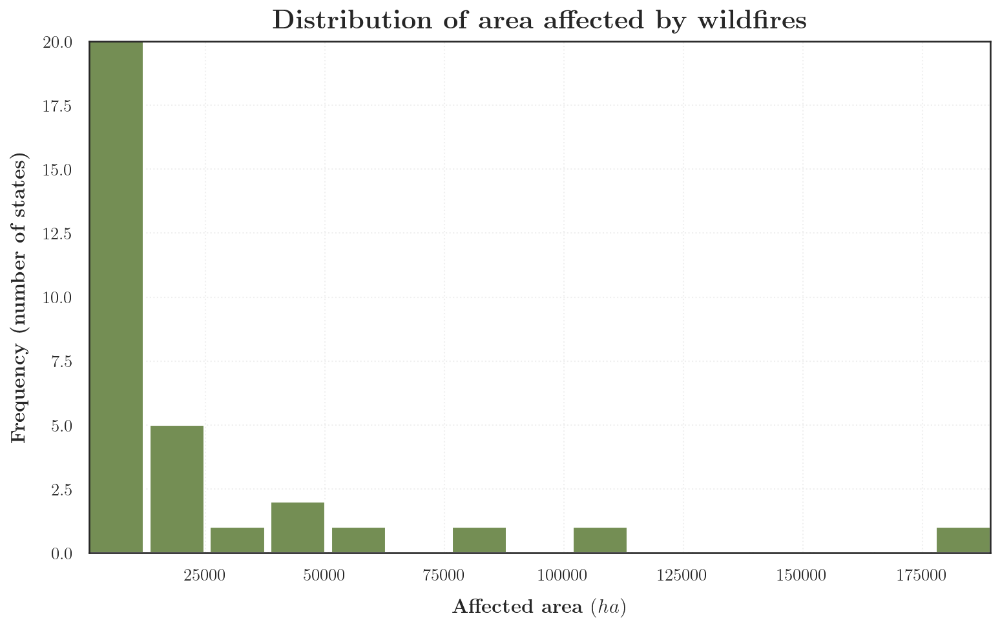

In [37]:
#seaborn font size and style of plot
sns.set( style = 'white' )

#matplotlib font type
plt.rc('font', family='serif')

plt.figure(figsize=(12,7), facecolor='white', dpi = 150)
ax = plt.axes()
ax.set_facecolor('white')

plt.hist(x=affected_area_states['Affected area (ha)'],
         bins = 15,
         rwidth = 0.9,
         color = '#748E54' 
         )

plt.title(r'\textbf{Distribution of area affected by wildfires}', pad = 10, size = 20)
plt.xlabel(r'\textbf{Affected area} ($ha$)', labelpad = 10, size = 15)
plt.ylabel(r'\textbf{Frequency (number of states)}', labelpad = 10, size = 15)
plt.tick_params(labelsize = 13)
plt.grid(b=True, ls = 'dotted', alpha = 0.3)
plt.show()

In [38]:
affected_area_states['Category']  = pd.cut(affected_area_states['Affected area (ha)'], bins=[0.,10000, 25000, 50000,75000,125000, np.inf],  labels=[1, 2, 3, 4, 5,6])
affected_area_states.head()

,STATE,Affected area (ha),IDNAME,Category
0,Aguascalientes,4734.55,AS,1
1,Baja California,50948.87,BC,4
2,Baja California Sur,76.64,BS,1
3,Campeche,13817.50,CC,2
4,Chiapas,13001.83,CS,2


### Coloured Map

The function we are going to use is `GeoJson()` and its parameters are:

+ `data` _(file, dict_ or _str)_ : The GeoJSON data you want to plot.
+ `style_function` _(function)_ : The function that maps a GeoJSON feature to a style dict. In our case teh style dict is the following:
```Python
style_function = lambda feature: {
                                    'fill_color': COLOUR_FUNCTION(feature),
                                    'fillOpacity': 0.95, 
                                    'color': 'black' #contour colour,
                                    'weight': 1 #tickness of the colour
                                 }
```

#### Creation of `COLOR_FUNCTION`

In [39]:
map_dict = affected_area_states.set_index('IDNAME')['Category'].to_dict()

In [40]:
def get_color(feature):
    value = map_dict.get(feature['id'])
    if value is None:
        return '#8c8c8c' # MISSING -> gray
    elif value ==1 :
        return '#DAF7A6'
    elif value ==2 :
        return '#FFC300'
    elif value ==3 :
        return '#FF5733'
    elif value ==4 :
        return '#C70039'
    elif value ==5 :
        return '#900C3F'
    elif value ==6 :# 
        return '#581845'  

In [41]:
map_affected_area_states = folium.Map (location=[24,-102], zoom_start=5)

folium.GeoJson(
    data=states_geo_json,
    style_function = lambda feature: {
        'fillColor': get_color(feature),
        'fillOpacity': 0.95,
        'color' : 'black',
        'weight' : 1,
    }    
).add_to(map_affected_area_states)

map_affected_area_states

### Map with legend

In [42]:
from branca.element import Template, MacroElement

template = """
{% macro html(this, kwargs) %}

<!doctype html>
<html lang="en">
<head>
  <meta charset="utf-8">
  <meta name="viewport" content="width=device-width, initial-scale=1">
  <title>jQuery UI Draggable - Default functionality</title>
  <link rel="stylesheet" href="//code.jquery.com/ui/1.12.1/themes/base/jquery-ui.css">

  <script src="https://code.jquery.com/jquery-1.12.4.js"></script>
  <script src="https://code.jquery.com/ui/1.12.1/jquery-ui.js"></script>
  
  <script>
  $( function() {
    $( "#maplegend" ).draggable({
                    start: function (event, ui) {
                        $(this).css({
                            right: "auto",
                            top: "auto",
                            bottom: "auto"
                        });
                    }
                });
});

  </script>
</head>
<body>

 
<div id='maplegend' class='maplegend' 
    style='position: absolute; z-index:9999; border:2px solid grey; background-color:rgba(255, 255, 255, 0.8);
     border-radius:6px; padding: 10px; font-size:14px; right: 20px; bottom: 20px;'>
     
<div class='legend-title'>Affected area by wildfires in Mexico (2017)</div>
<div class='legend-scale'>
  <ul class='legend-labels'>
    <li><span style='background:#DAF7A6;'></span>0 ha to 10,000 ha </li>
    <li><span style='background:#FFC300;'></span>10,001 ha to 25,000 ha </li>
    <li><span style='background:#FF5733;'></span>25,001 ha to 50,000 ha </li>
    <li><span style='background:#C70039;'></span>50,001 ha to 75,000 ha </li>
    <li><span style='background:#900C3F;'></span>75,001 ha to 125,000 ha </li>
    <li><span style='background:#581845;'></span>More than 125,000 ha </li>



  </ul>
</div>
</div>
 
</body>
</html>

<style type='text/css'>
  .maplegend .legend-title {
    text-align: left;
    margin-bottom: 5px;
    font-weight: bold;
    font-size: 90%;
    }
  .maplegend .legend-scale ul {
    margin: 0;
    margin-bottom: 5px;
    padding: 0;
    float: left;
    list-style: none;
    }
  .maplegend .legend-scale ul li {
    font-size: 80%;
    list-style: none;
    margin-left: 0;
    line-height: 18px;
    margin-bottom: 2px;
    }
  .maplegend ul.legend-labels li span {
    display: block;
    float: left;
    height: 16px;
    width: 30px;
    margin-right: 5px;
    margin-left: 0;
    border: 1px solid #999;
    }
  .maplegend .legend-source {
    font-size: 80%;
    color: #777;
    clear: both;
    }
  .maplegend a {
    color: #777;
    }
</style>
{% endmacro %}"""

macro = MacroElement()
macro._template = Template(template)

map_affected_area_states.get_root().add_child(macro)
map_affected_area_states

# Discussion

The Secretary of Environment and Natural Resources (SEMARNAT) has a register open to the public of the number of wildfires per state per year [[5]](http://dgeiawf.semarnat.gob.mx:8080/ibi_apps/WFServlet?IBIF_ex=D3_RFORESTA05_01&IBIC_user=dgeia_mce&IBIC_pass=dgeia_mce&NOMBREENTIDAD=*&NOMBREANIO=*) so we can easily check if the data provided by them is what is open to the public. Doing this practice, even if it sounds _dumb_, is important.


In [43]:
number_wildfires_states = df.groupby(by='STATE').count()[['Affected area (ha)']].reset_index().rename(columns={'Affected area (ha)': 'Number of wildfires'})
number_wildfires_states.iloc[6,0] = 'CDMX'
number_wildfires_states.iloc[16,0] = 'Estado de México'
number_wildfires_states

,STATE,Number of wildfires
0,Aguascalientes,79
1,Baja California,193
2,Baja California Sur,14
3,Campeche,29
4,Chiapas,390
5,Chihuahua,808
6,CDMX,653
7,Coahuila,154
8,Colima,84
9,Durango,509


In [44]:
from IPython.display import IFrame

url = 'http://dgeiawf.semarnat.gob.mx:8080/ibi_apps/WFServlet?IBIF_ex=D3_RFORESTA05_01&IBIC_user=dgeia_mce&IBIC_pass=dgeia_mce&NOMBREENTIDAD=*&NOMBREANIO=*'
IFrame(url, width=900, height=500)

At the end of the review we could see that indeed the information they share with us on the website is the same as the one we have collected with the public data from CONAFOR.



# Conclusions

Thanks to FOLIUM, we could present the behaviour of the wildfires in Mexico during 2017, like:
* Wildfire proximity
* Wildfire time duration
* Total affected area for each wildfire and each state
All of this thanks to the following FOLIUM functions:
* **`Map`**
* **`HeatMap`**
* **`Circle`**
* **`GeoJson`**

So, next time that you encounter data with geographic information do not hesitate to use FOLIUM.

We understand that there are other tools out there; we don't want to minimize them. We're just presenting another tool. 


To see the full tutorial, visit the following [**GitHub Repository**](https://github.com/isaacarroyov/data_visualization_practice/tree/master/Folium/Wildfires)



# References
[1] https://library.itc.utwente.nl/papers_2008/msc/nrm/orozco.pdf
 
[2] https://www.datos.gob.mx/busca/organization/conafor

[3] http://187.218.230.4/OpenData/Incendios/

[4] https://python-visualization.github.io/folium/

[5] http://dgeiawf.semarnat.gob.mx:8080/ibi_apps/WFServlet?IBIF_ex=D3_RFORESTA05_01&IBIC_user=dgeia_mce&IBIC_pass=dgeia_mce&NOMBREENTIDAD=*&NOMBREANIO=*